In [118]:
from glob import glob

import warnings
warnings.filterwarnings('ignore') # :clown:

In [119]:
import numpy as np
import pandas as pd

In [120]:
import matplotlib.pyplot as plt

In [121]:
files = glob('../data/ecg_preprocessed/*.csv')

In [284]:
df = pd.read_csv(files[0])
df.head()

,timestamp,signal,signal_normalised,subject_id,category,code,ECG_Raw,ECG_Clean,ECG_Rate,ECG_Quality,...,ECG_R_Onsets,ECG_R_Offsets,ECG_S_Peaks,ECG_T_Peaks,ECG_T_Onsets,ECG_T_Offsets,ECG_Phase_Atrial,ECG_Phase_Completion_Atrial,ECG_Phase_Ventricular,ECG_Phase_Completion_Ventricular
0,2017-12-15 10:16:06+00:00,-0.000073,0.493088,30100,NaN,NaN,-0.000073,-0.000095,64.763176,0.998214,...,0,0,0,0,0,0,NaN,0.0,NaN,0.0
1,2017-12-15 10:16:06.001000+00:00,-0.000083,0.492200,30100,NaN,NaN,-0.000083,-0.000097,64.763176,0.998214,...,0,0,0,0,0,0,NaN,0.0,NaN,0.0
2,2017-12-15 10:16:06.002000+00:00,-0.000095,0.491090,30100,NaN,NaN,-0.000095,-0.000100,64.763176,0.998214,...,0,0,0,0,0,0,NaN,0.0,NaN,0.0
3,2017-12-15 10:16:06.003000+00:00,-0.000103,0.490368,30100,NaN,NaN,-0.000103,-0.000102,64.763176,0.998214,...,0,0,0,0,0,0,NaN,0.0,NaN,0.0
4,2017-12-15 10:16:06.004000+00:00,-0.000110,0.489757,30100,NaN,NaN,-0.000110,-0.000105,64.763176,0.998214,...,0,0,0,0,0,0,NaN,0.0,NaN,0.0


In [215]:
import sys
sys.path.insert(0, '..')

In [254]:
import neurokit2 as nk

In [285]:
# sample = df[:1000 * 5]['signal']

idx = 8342861
window = 5000

sample = df['signal'][int(abs(idx-(window/2))):int(abs(idx + (window/2)))].values

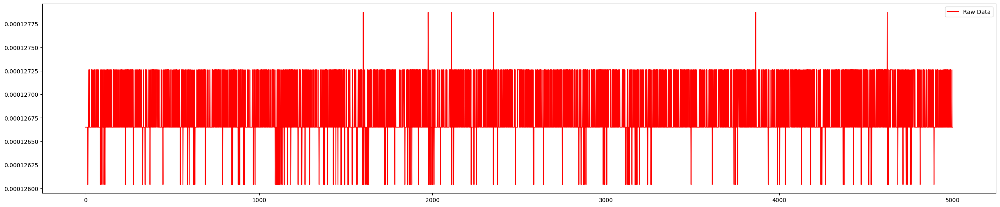

In [303]:
plt.figure(figsize=(30,6))
plt.plot(sample, color='red')
plt.legend(['Raw Data'], loc='best')
plt.show()

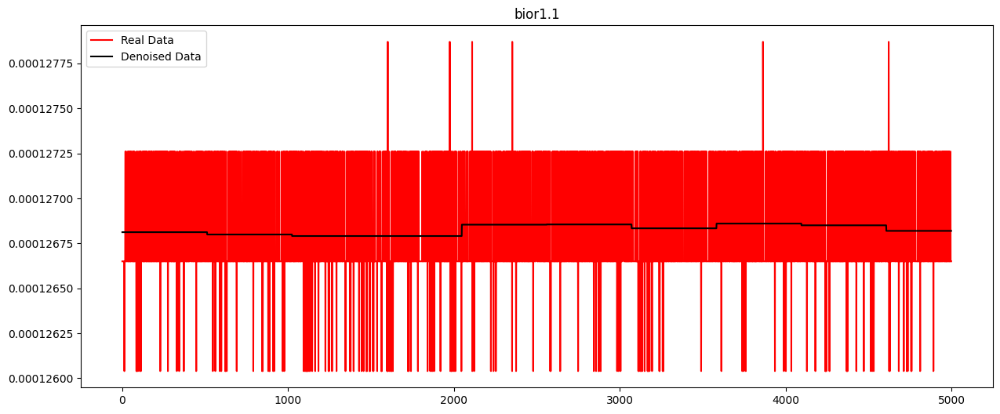

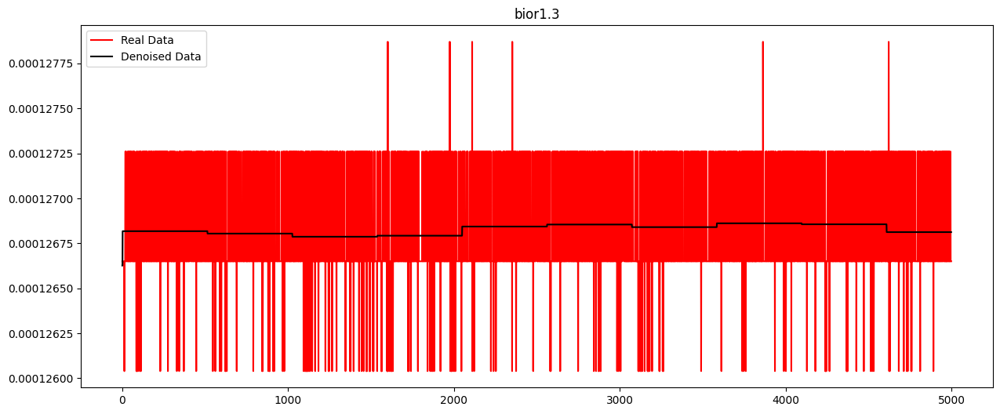

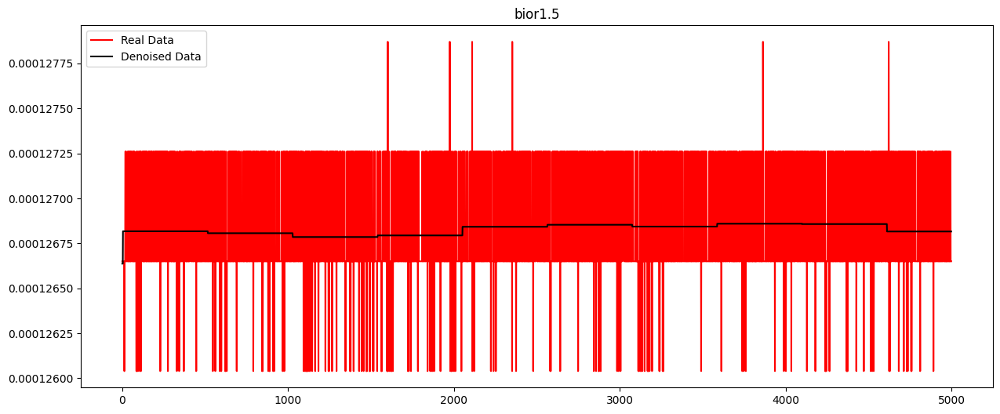

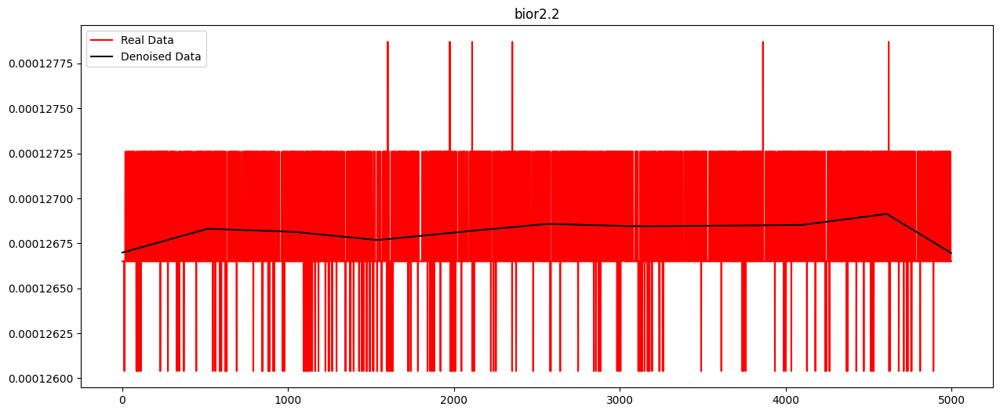

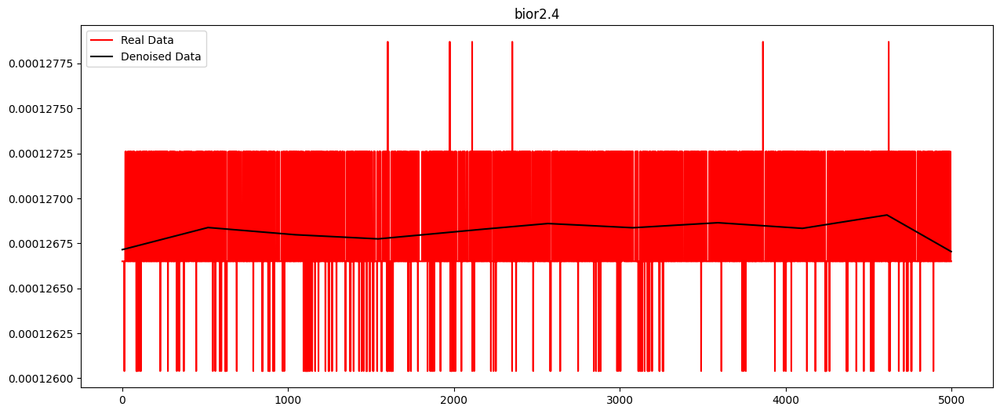

...

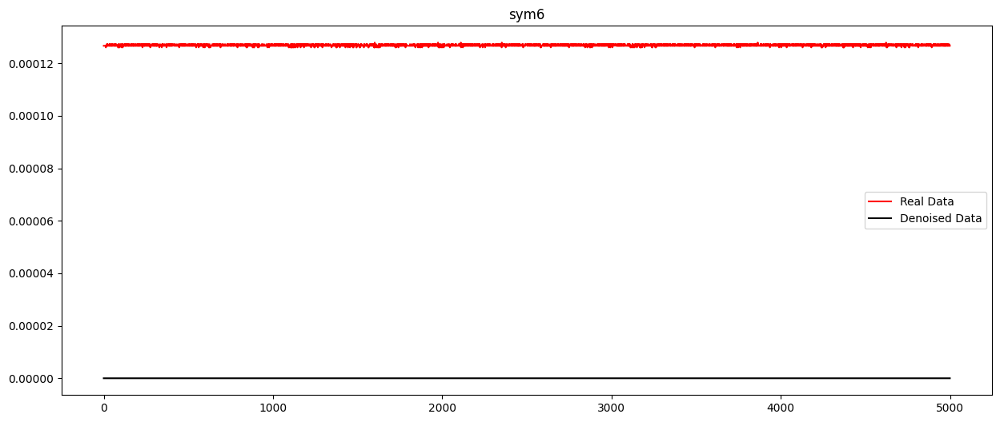

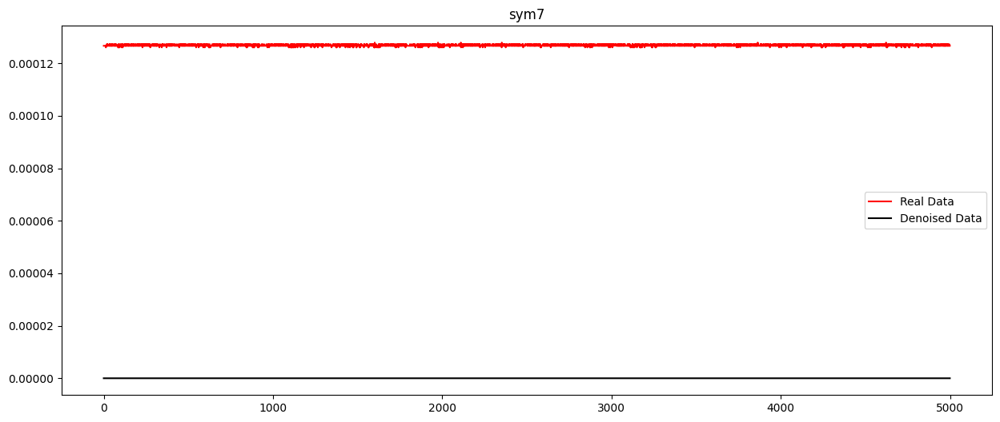

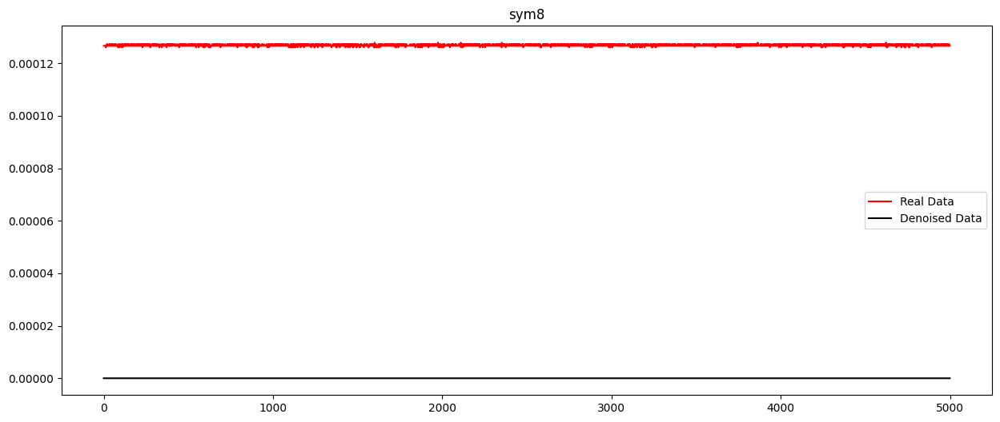

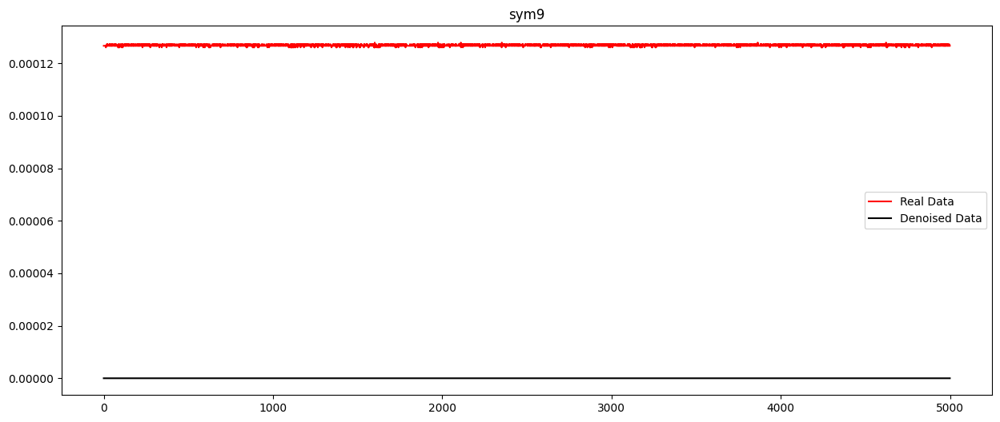

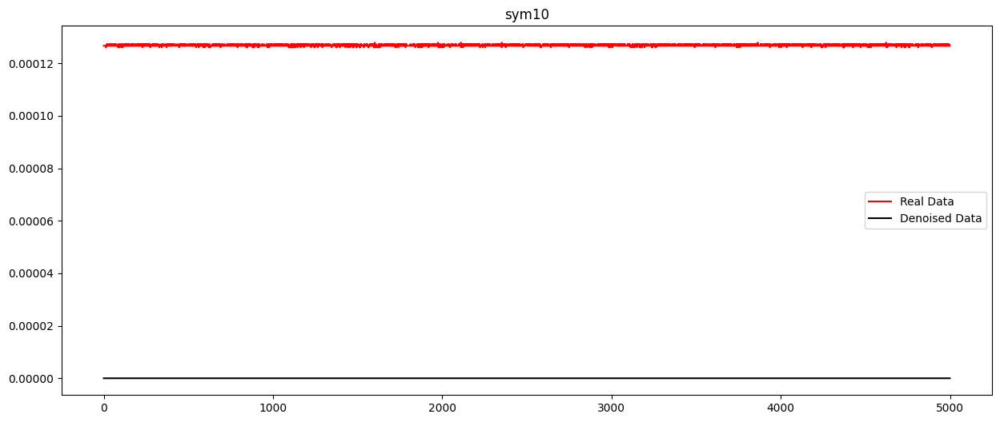

In [301]:
import pywt

for wav in pywt.wavelist():
    try: 
        DWTcoeffs = pywt.wavedec(sample, wav)
        DWTcoeffs[-1] = np.zeros_like(DWTcoeffs[-1])
        DWTcoeffs[-2] = np.zeros_like(DWTcoeffs[-2])
        DWTcoeffs[-3] = np.zeros_like(DWTcoeffs[-3])
        DWTcoeffs[-4] = np.zeros_like(DWTcoeffs[-4])
        DWTcoeffs[-5] = np.zeros_like(DWTcoeffs[-5])
        DWTcoeffs[-6] = np.zeros_like(DWTcoeffs[-6])
        DWTcoeffs[-7] = np.zeros_like(DWTcoeffs[-7])
        DWTcoeffs[-8] = np.zeros_like(DWTcoeffs[-8])
        DWTcoeffs[-9] = np.zeros_like(DWTcoeffs[-9])

        filtered_data_dwt=pywt.waverec(DWTcoeffs,wav,mode='symmetric',axis=-1)

        plt.figure(figsize=(15,6))
        plt.plot(sample, color='red')
        plt.plot(filtered_data_dwt, markerfacecolor='none',color='black')
        plt.legend(['Real Data', 'Denoised Data'], loc='best')
        plt.title(wav)
        plt.show()
    except:
        continue

In [256]:
processed_df, _ = nk.ecg_process(list(sample), sampling_rate=1000, method='elgendi2010')
sample = processed_df['ECG_Clean']

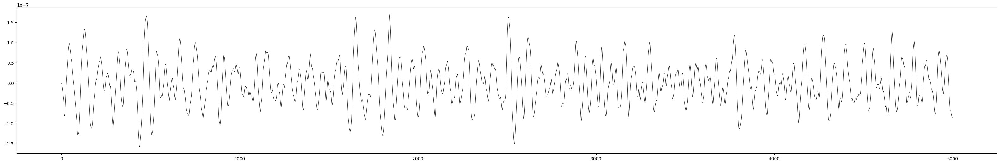

In [257]:
plt.figure(figsize=(40,6))
plt.plot(sample, color='black', linewidth=0.6)
# plt.hlines(0,0,len(sample),color='black', linewidth=0.3)

## Bior4.4 Wavelet Transform
From https://www.kaggle.com/code/nelsonsharma/ecg-02-ecg-signal-pre-processing

In [258]:
import pywt
from pywt import wavedec

In [259]:
def denoise_signal(X, dwt_transform, dlevels, cutoff_low, cutoff_high):
    coeffs = wavedec(X, dwt_transform, level=dlevels)   # wavelet transform 'bior4.4'
    
    for ca in range(0,cutoff_low):
        coeffs[ca]=np.multiply(coeffs[ca],[0.0])
        
    for ca in range(cutoff_high, len(coeffs)):
        coeffs[ca]=np.multiply(coeffs[ca],[0.0])

    Y = pywt.waverec(coeffs, dwt_transform) # inverse wavelet transform
    
    return Y  


signal_den = denoise_signal(sample,'bior4.4', 9 , 1 , 7) #<--- trade off - the less the cutoff - th

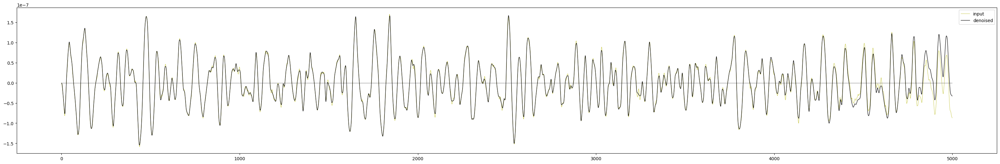

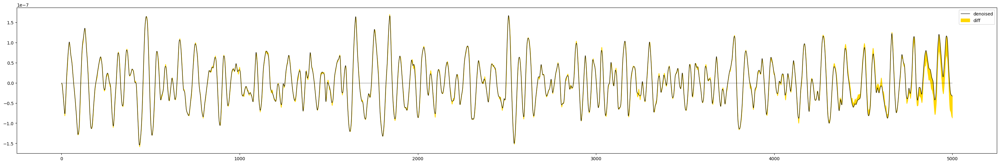

In [260]:
plt.figure(figsize=(40,6))

plt.plot(sample, color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(signal_den, color='black', linewidth=0.9,label = 'denoised')
plt.hlines(0,0,len(sample),color='black', linewidth=0.4)
plt.legend()
plt.show()

plt.figure(figsize=(40,6))
plt.plot(signal_den, color='black', linewidth=0.9,label = 'denoised')
plt.fill_between(np.arange(0,len(sample),1),sample,signal_den,color='gold',label = 'diff')
plt.hlines(0,0,len(sample),color='black', linewidth=0.4)
plt.legend()
plt.show()

## Remove Baseline Wander
From https://www.kaggle.com/code/nelsonsharma/ecg-02-ecg-signal-pre-processing

In [261]:
from scipy.signal import medfilt

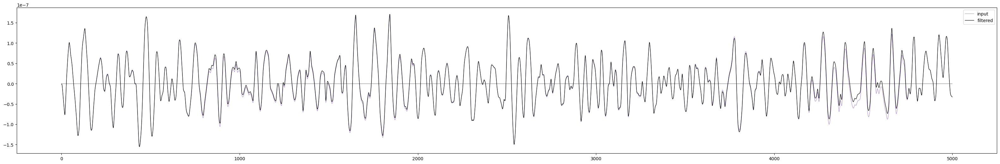

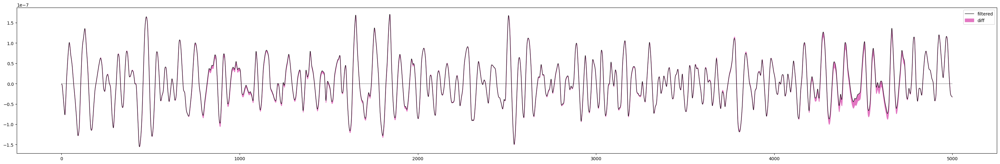

In [262]:
def get_median_filter_width(sampling_rate, duration):
    res = int( sampling_rate*duration )
    res += ((res%2) - 1) # needs to be an odd number
    return res

# === Define Filtering Params for Baseline fitting Leads======================
ms_flt_array = [0.2,0.6]    #<-- length of baseline fitting filters (in seconds)
mfa = np.zeros(len(ms_flt_array), dtype='int')
for i in range(0, len(ms_flt_array)):
    mfa[i] = get_median_filter_width(1000, ms_flt_array[i])

def filter_signal(X):
    global mfa
    X0 = X  #read orignal signal
    for mi in range(0,len(mfa)):
        X0 = medfilt(X0,mfa[mi]) # apply median filter one by one on top of each other
    X0 = np.subtract(X,X0)  # finally subtract from orignal signal
    return X0



signal_flt = filter_signal(signal_den)
plt.figure(figsize=(40,6))

plt.plot(signal_den, color='tab:purple', linewidth=0.6,label = 'input')
plt.plot(signal_flt, color='black', linewidth=0.9,label = 'filtered')
plt.hlines(0,0,len(sample),color='black', linewidth=0.4)
plt.legend()
plt.show()

plt.figure(figsize=(40,6))
plt.plot(signal_flt, color='black', linewidth=0.9,label = 'filtered')
plt.fill_between(np.arange(0,len(sample),1),signal_den,signal_flt,color='tab:pink',label = 'diff')
plt.hlines(0,0,len(sample),color='black', linewidth=0.4)
plt.legend()
plt.show()

## Difference

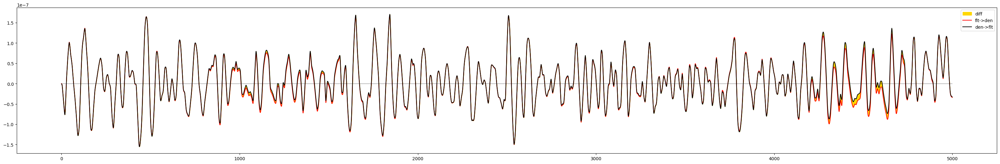

In [263]:
s1 = denoise_signal(filter_signal(sample),'bior4.4', 9 , 1 , 7) # first filtered then denoised
s2 = filter_signal(denoise_signal(sample,'bior4.4', 9 , 1 , 7)) #first denoised then filtered

plt.figure(figsize=(40,6))

plt.fill_between(np.arange(0,len(sample),1),s1,s2,color='gold',label = 'diff')
plt.plot(s1, color='red',label = 'flt->den')
plt.plot(s2, color='black',label = 'den->flt')
plt.hlines(0,0,len(sample),color='black', linewidth=0.4)
plt.legend()
plt.show()

## R-Peak Detection

In [264]:
from ecgdetectors import Detectors
detectors = Detectors(1000) # hz

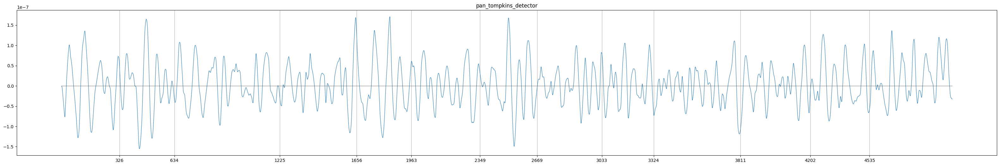

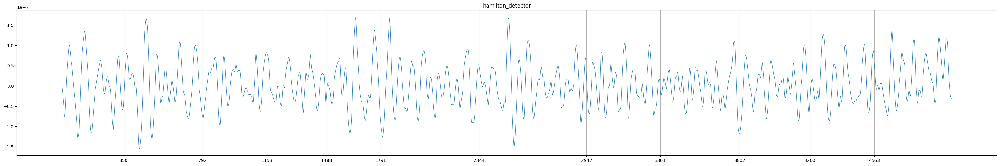

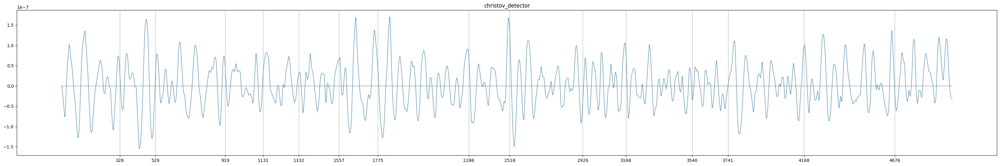

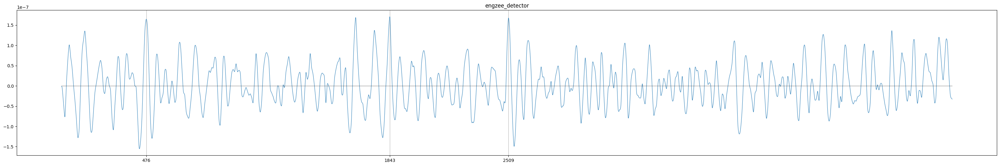

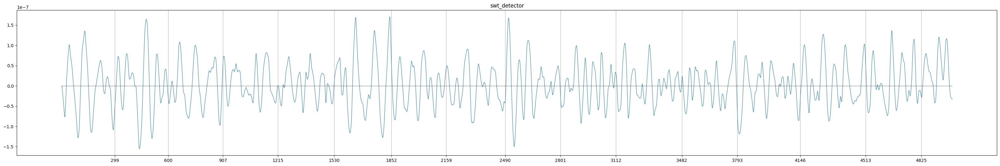

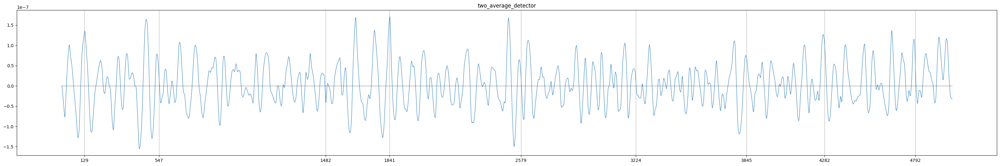

In [265]:
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly
signalf = signal_flt

detectors = {
    'pan_tompkins_detector':[detectors.pan_tompkins_detector, []],
    'hamilton_detector':[detectors.hamilton_detector, []],
    'christov_detector':[detectors.christov_detector, []],
    'engzee_detector':[detectors.engzee_detector, []],
    'swt_detector':[detectors.swt_detector, []],
    'two_average_detector':[detectors.two_average_detector, []],
}


for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,signal_flt)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(signalf,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,len(sample),color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

## Fourier Transform

In [266]:
from scipy.fft import fft, ifft, fftfreq

In [267]:
def get_fft_values(y_values, hz):
    t_n = len(y_values) / hz
    N = len(y_values)
    T = t_n / N
    f_s = hz

    f_values = np.linspace(0.0, 1.0/(2.0*T), N//2)
    fft_values_ = fft(y_values)
    fft_values = 2.0/N * np.abs(fft_values_[0:N//2])
    return f_values, fft_values

In [268]:
# import mpl_toolkits.mplot3d

# x_value = np.linspace(0,t_n,N)
# amplitudes = [4, 6, 8, 10, 14]
# frequencies = [6.5, 5, 3, 1.5, 1]
# y_values = [amplitudes[ii]*np.sin(2*np.pi*frequencies[ii]*x_value) for ii in range(0,len(amplitudes))]
# composite_y_value = np.sum(y_values, axis=0)
 
# f_values, fft_values = get_fft_values(composite_y_value, 1000)
 
# colors = ['k', 'b', 'b', 'b', 'b', 'b', 'b', 'b', 'b']
 
# fig = plt.figure(figsize=(8,8))
# ax = fig.add_subplot(111, projection='3d')
# ax.set_xlabel("\nTime [s]", fontsize=16)
# ax.set_ylabel("\nFrequency [Hz]", fontsize=16)
# ax.set_zlabel("\nAmplitude", fontsize=16)
 
# y_values_ = [composite_y_value] + list(reversed(y_values))
# frequencies = [1, 1.5, 3, 5, 6.5]
 
# for ii in range(0,len(y_values_)):
#     signal = y_values_[ii]
#     color = colors[ii]
#     length = signal.shape[0]
#     x=np.linspace(0,10,1000)
#     y=np.array([frequencies[ii]]*length)
#     z=signal
 
#     if ii == 0:
#         linewidth = 4
#     else:
#         linewidth = 2
#     ax.plot(list(x), list(y), zs=list(z), linewidth=linewidth, color=color)
 
#     x=[10]*75
#     y=f_values[:75]
#     z = fft_values[:75]*3
#     ax.plot(list(x), list(y), zs=list(z), linewidth=2, color='red')
    
#     plt.tight_layout()
# plt.show()

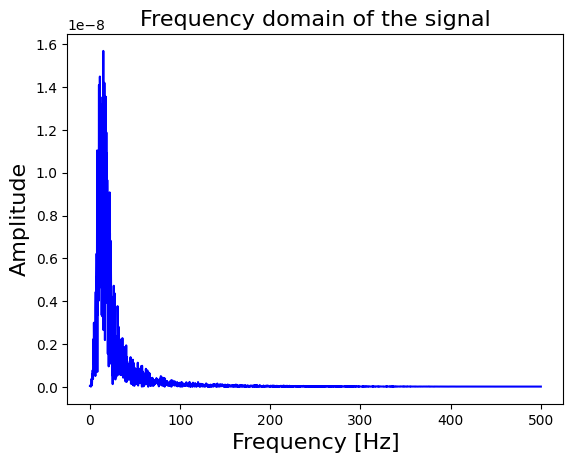

In [269]:
f_values, fft_values = get_fft_values(list(sample), 1000)

plt.plot(f_values, fft_values, linestyle='-', color='blue')
plt.xlabel('Frequency [Hz]', fontsize=16)
plt.ylabel('Amplitude', fontsize=16)
plt.title("Frequency domain of the signal", fontsize=16)
plt.show()

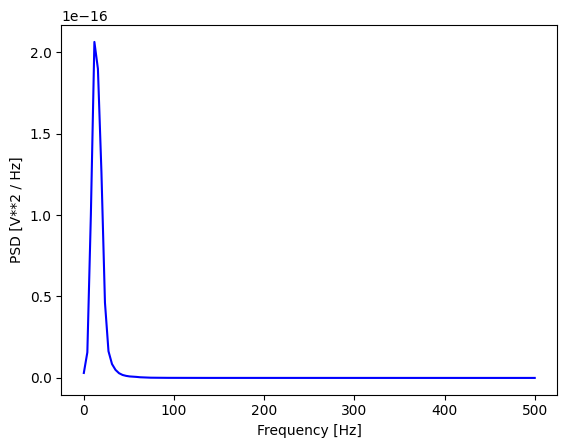

In [270]:
from scipy.signal import welch

def get_psd_values(y_values, hz):
    f_values, psd_values = welch(y_values, fs=hz)
    return f_values, psd_values
 
f_values, psd_values = get_psd_values(list(sample), 1000)
 
plt.plot(f_values, psd_values, linestyle='-', color='blue')
plt.xlabel('Frequency [Hz]')
plt.ylabel('PSD [V**2 / Hz]')
plt.show()

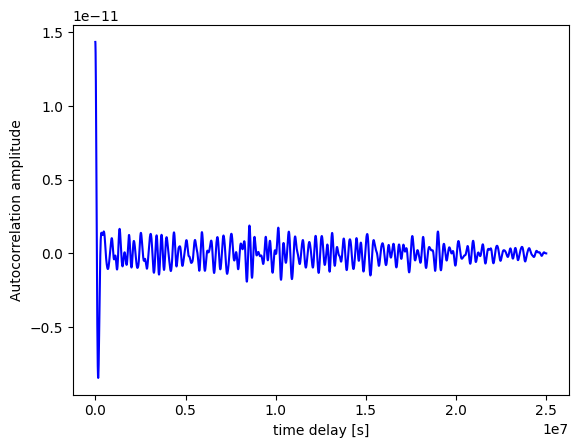

In [271]:
def autocorr(x):
    result = np.correlate(x, x, mode='full')
    return result[len(result)//2:]
 
def get_autocorr_values(y_values):
    autocorr_values = autocorr(y_values)
    x_values = np.array([len(y_values) * jj for jj in range(0, len(y_values))])
    return x_values, autocorr_values
 
t_values, autocorr_values = get_autocorr_values(list(sample))
 
plt.plot(t_values, autocorr_values, linestyle='-', color='blue')
plt.xlabel('time delay [s]')
plt.ylabel('Autocorrelation amplitude')
plt.show()

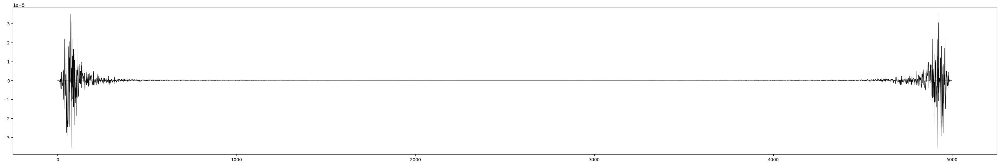

In [272]:
plt.figure(figsize=(40,6))
plt.plot(fft(list(sample)), color='black', linewidth=0.6)
plt.hlines(0,0,len(sample),color='black', linewidth=0.3)

## PyWavelets

In [273]:
import pywt

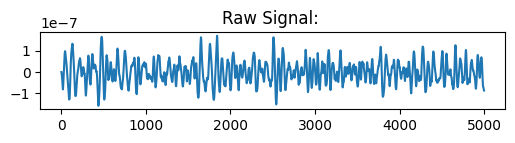

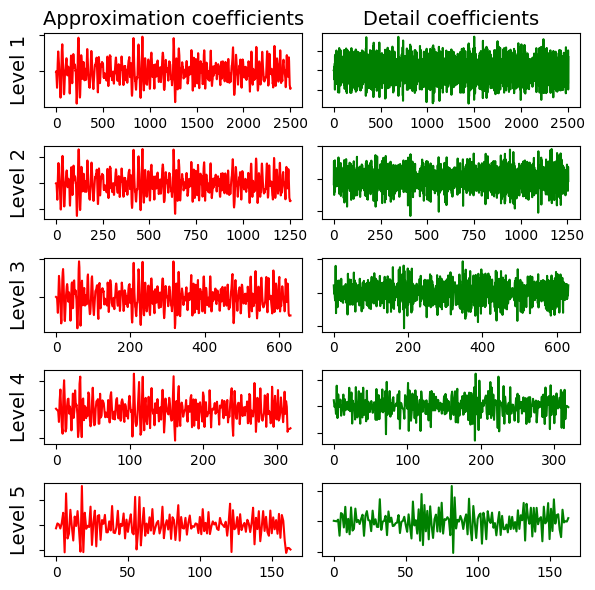

In [274]:
x = np.linspace(0, 1, num=2048)
    
fig, ax = plt.subplots(figsize=(6,1))
ax.set_title("Raw Signal: ")
ax.plot(sample)
plt.show()
    
data = sample
waveletname = 'sym5'
 
fig, axarr = plt.subplots(nrows=5, ncols=2, figsize=(6,6))
for ii in range(5):
    (data, coeff_d) = pywt.dwt(data, waveletname)
    axarr[ii, 0].plot(data, 'r')
    axarr[ii, 1].plot(coeff_d, 'g')
    axarr[ii, 0].set_ylabel("Level {}".format(ii + 1), fontsize=14, rotation=90)
    axarr[ii, 0].set_yticklabels([])
    if ii == 0:
        axarr[ii, 0].set_title("Approximation coefficients", fontsize=14)
        axarr[ii, 1].set_title("Detail coefficients", fontsize=14)
    axarr[ii, 1].set_yticklabels([])
plt.tight_layout()
plt.show()

In [142]:
# hz = 1000

# def get_ave_values(xvalues, yvalues, n = 5):
#     signal_length = len(xvalues)
#     if signal_length % n == 0:
#         padding_length = 0
#     else:
#         padding_length = n - signal_length//n % n
#     xarr = np.array(xvalues)
#     yarr = np.array(yvalues)
#     xarr.resize(signal_length//n, n)
#     yarr.resize(signal_length//n, n)
#     xarr_reshaped = xarr.reshape((-1,n))
#     yarr_reshaped = yarr.reshape((-1,n))
#     x_ave = xarr_reshaped[:,0]
#     y_ave = np.nanmean(yarr_reshaped, axis=1)
#     return x_ave, y_ave

# def plot_wavelet(time, signal, scales, 
#                  waveletname = 'cmor', 
#                  cmap = plt.cm.seismic, 
#                  title = 'Wavelet Transform (Power Spectrum) of signal', 
#                  ylabel = 'Period', 
#                  xlabel = 'Time'):
    
#     [coefficients, frequencies] = pywt.cwt(signal, scales, waveletname, hz / 1000)
#     power = (abs(coefficients)) ** 2
#     period = 1. / frequencies
#     levels = [0.0625, 0.125, 0.25, 0.5, 1, 2, 4, 8]
#     contourlevels = np.log2(levels)
    
#     fig, ax = plt.subplots(figsize=(15, 10))
#     im = ax.contourf(time, np.log2(period), np.log2(power), contourlevels, extend='both',cmap=cmap)
    
#     ax.set_title(title, fontsize=20)
#     ax.set_ylabel(ylabel, fontsize=18)
#     ax.set_xlabel(xlabel, fontsize=18)
    
#     yticks = 2**np.arange(np.ceil(np.log2(period.min())), np.ceil(np.log2(period.max())))
#     ax.set_yticks(np.log2(yticks))
#     ax.set_yticklabels(yticks)
#     ax.invert_yaxis()
#     ylim = ax.get_ylim()
#     ax.set_ylim(ylim[0], -1)
    
#     cbar_ax = fig.add_axes([0.95, 0.5, 0.03, 0.25])
#     fig.colorbar(im, cax=cbar_ax, orientation="vertical")
#     plt.show()
 
# def plot_signal_plus_average(time, signal, average_over = 5):
#     fig, ax = plt.subplots(figsize=(15, 3))
#     time_ave, signal_ave = get_ave_values(time, signal, average_over)
#     ax.plot(time, signal, label='signal')
#     ax.plot(time_ave, signal_ave, label = 'time average (n={})'.format(5))
#     ax.set_xlim([time[0], time[-1]])
#     ax.set_ylabel('Signal Amplitude', fontsize=18)
#     ax.set_title('Signal + Time Average', fontsize=18)
#     ax.set_xlabel('Time', fontsize=18)
#     ax.legend()
#     plt.show()
 
# def plot_fft_plus_power(time, signal):
#     fig, ax = plt.subplots(figsize=(15, 3))
#     variance = np.std(signal)**2
#     f_values, fft_values = get_fft_values(signal, hz)
#     fft_power = variance * abs(fft_values) ** 2     # FFT power spectrum
#     ax.plot(f_values, fft_values, 'r-', label='Fourier Transform')
#     ax.plot(f_values, fft_power, 'k--', linewidth=1, label='FFT Power Spectrum')
#     ax.set_xlabel('Frequency [Hz]', fontsize=18)
#     ax.set_ylabel('Amplitude', fontsize=18)
#     ax.legend()
#     plt.show()

# scales = np.arange(1, 128)
# for category in df.category.unique()[1:]:
#     sample = df[df.category == category][:5000]
#     time = sample['timestamp'].values.squeeze()
#     signal_c = sample['signal'].values.squeeze()
#     plot_signal_plus_average(time, signal_c)
#     plot_fft_plus_power(time, signal_c)
#     plot_wavelet(time, signal_c, scales)

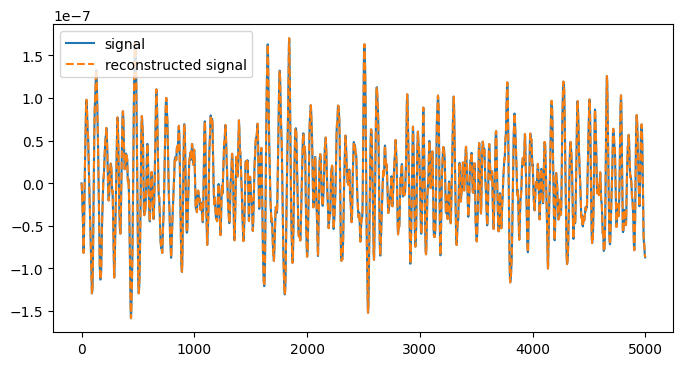

In [275]:
(cA1, cD1) = pywt.dwt(sample, 'db2', 'smooth')
reconstructed_signal = pywt.idwt(cA1, cD1, 'db2', 'smooth')

fig, ax = plt.subplots(figsize=(8,4))
ax.plot(sample, label='signal')
ax.plot(reconstructed_signal, label='reconstructed signal', linestyle='--')
ax.legend(loc='upper left')
plt.show()

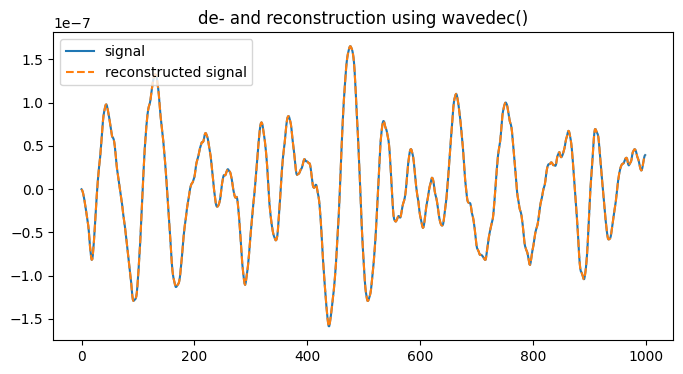

In [276]:
coeffs = pywt.wavedec(sample, 'db2', level=8)
reconstructed_signal = pywt.waverec(coeffs, 'db2')

fig, ax = plt.subplots(figsize=(8,4))
ax.plot(sample[:1000], label='signal')
ax.plot(reconstructed_signal[:1000], label='reconstructed signal', linestyle='--')
ax.legend(loc='upper left')
ax.set_title('de- and reconstruction using wavedec()')
plt.show()

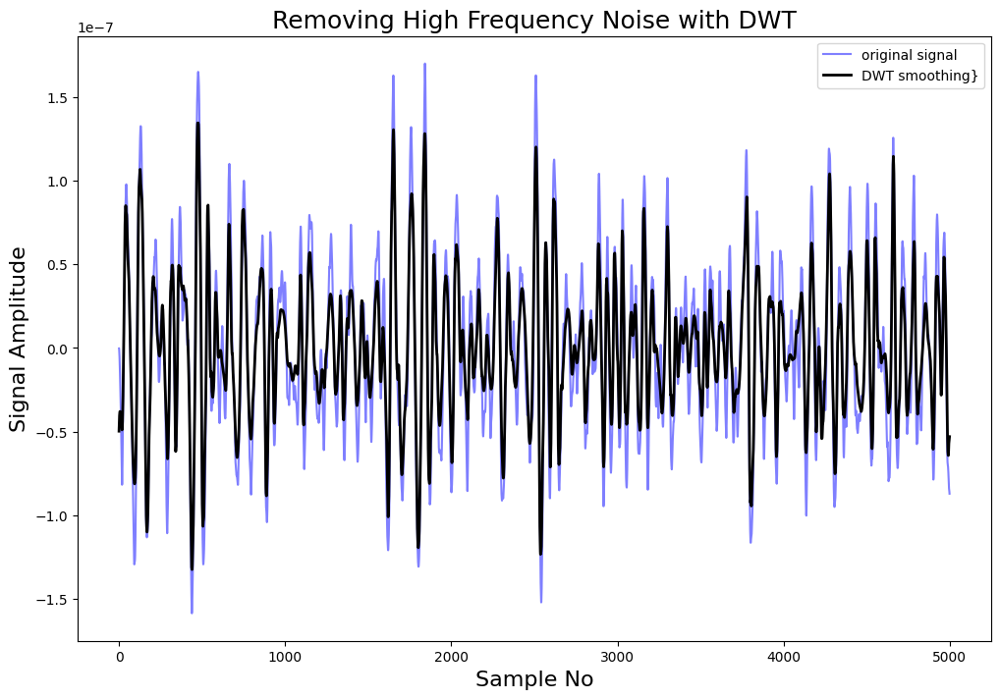

In [277]:
def lowpassfilter(signal, thresh = 0.63, wavelet="db4"):
    thresh = thresh*np.nanmax(signal)
    coeff = pywt.wavedec(signal, wavelet, mode="per" )
    coeff[1:] = (pywt.threshold(i, value=thresh, mode="soft" ) for i in coeff[1:])
    reconstructed_signal = pywt.waverec(coeff, wavelet, mode="per" )
    return reconstructed_signal

fig, ax = plt.subplots(figsize=(12,8))
ax.plot(sample, color="b", alpha=0.5, label='original signal')
rec = lowpassfilter(sample, 0.4)
ax.plot(rec, 'k', label='DWT smoothing}', linewidth=2)
ax.legend()
ax.set_title('Removing High Frequency Noise with DWT', fontsize=18)
ax.set_ylabel('Signal Amplitude', fontsize=16)
ax.set_xlabel('Sample No', fontsize=16)
plt.show()

### Wavelet

In [278]:
def madev(d, axis=None):
    """ Mean absolute deviation of a signal """
    return np.mean(np.absolute(d - np.mean(d, axis)), axis)

In [279]:
def wavelet_denoising(x, wavelet='db4', level=1):
    coeff = pywt.wavedec(x, wavelet, mode="per")
    sigma = (1/0.6745) * madev(coeff[-level])
    uthresh = sigma * np.sqrt(2 * np.log(len(x)))
    coeff[1:] = (pywt.threshold(i, value=uthresh, mode='hard') for i in coeff[1:])
    return pywt.waverec(coeff, wavelet, mode='per')

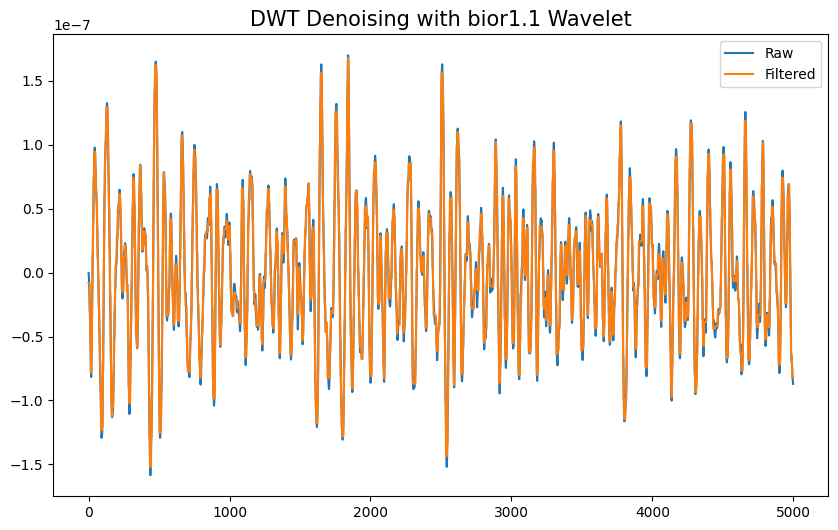

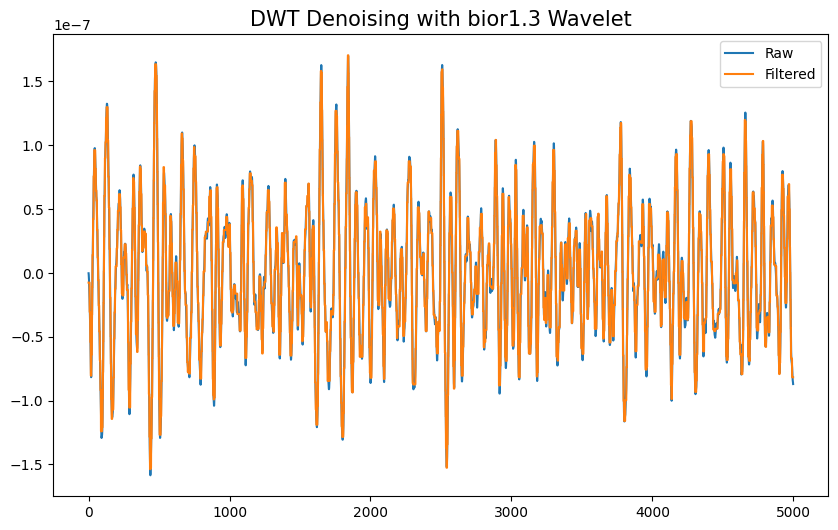

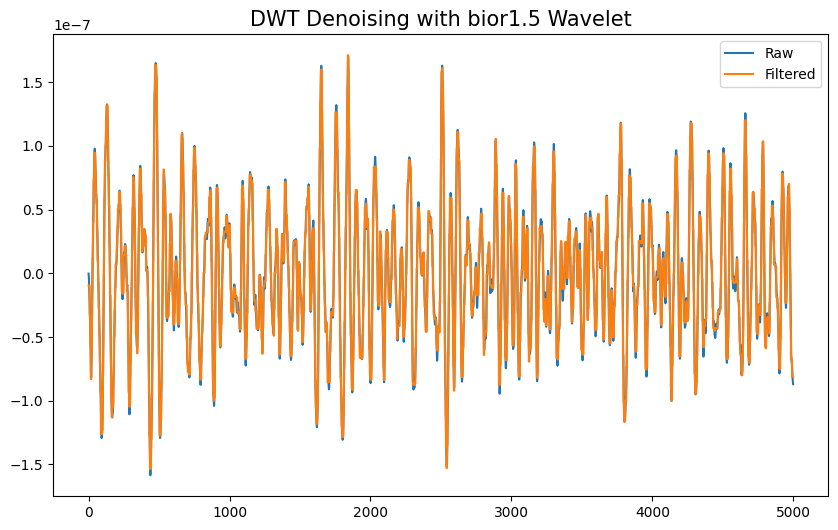

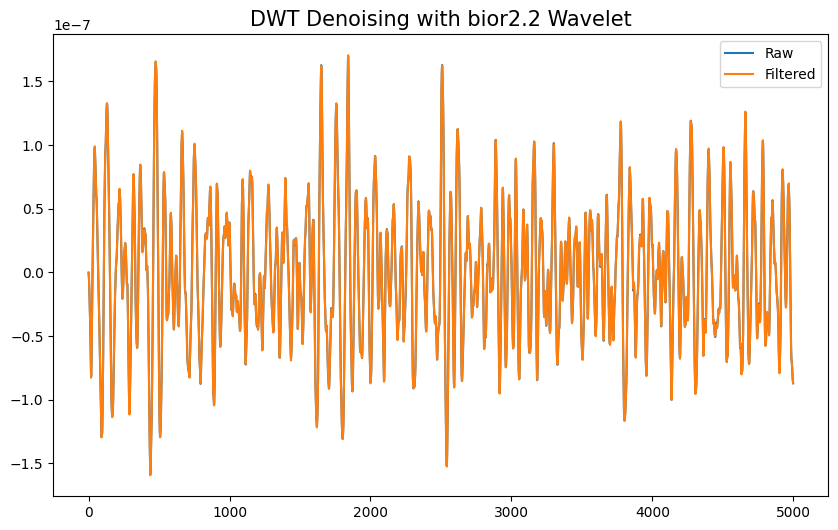

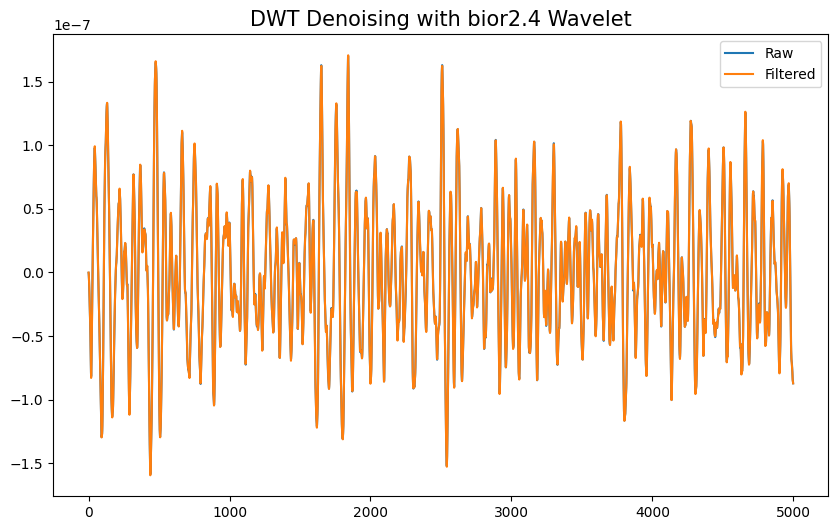

...

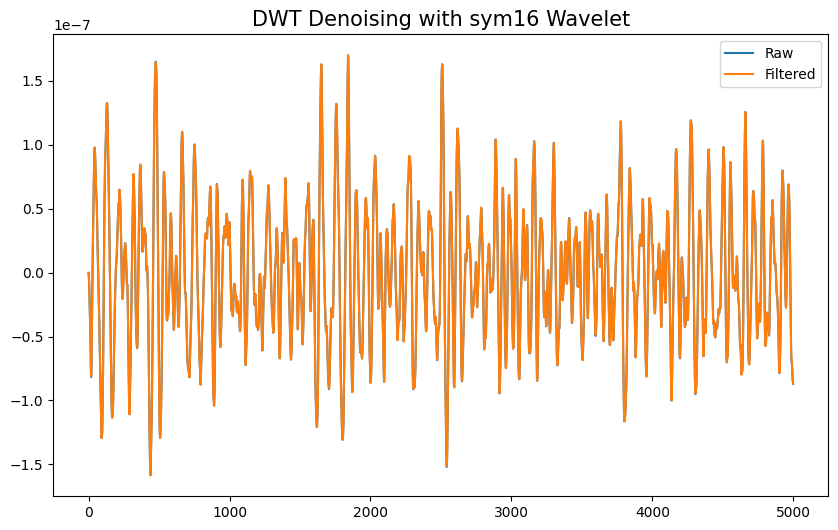

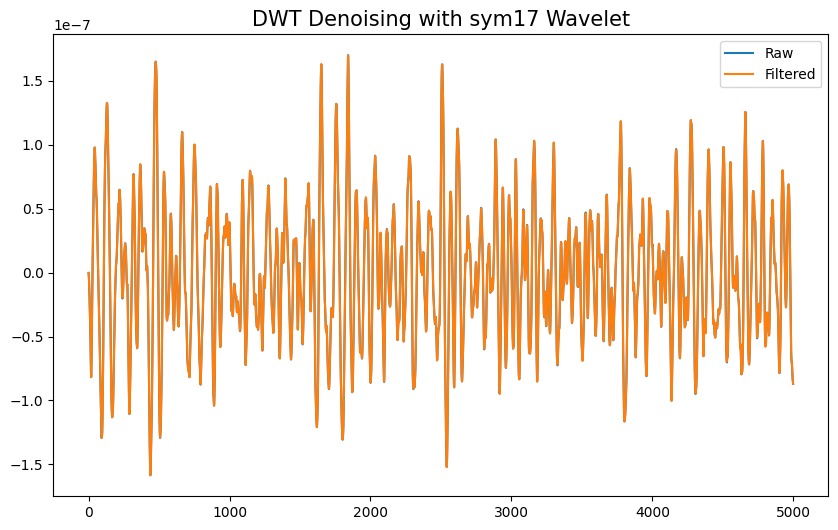

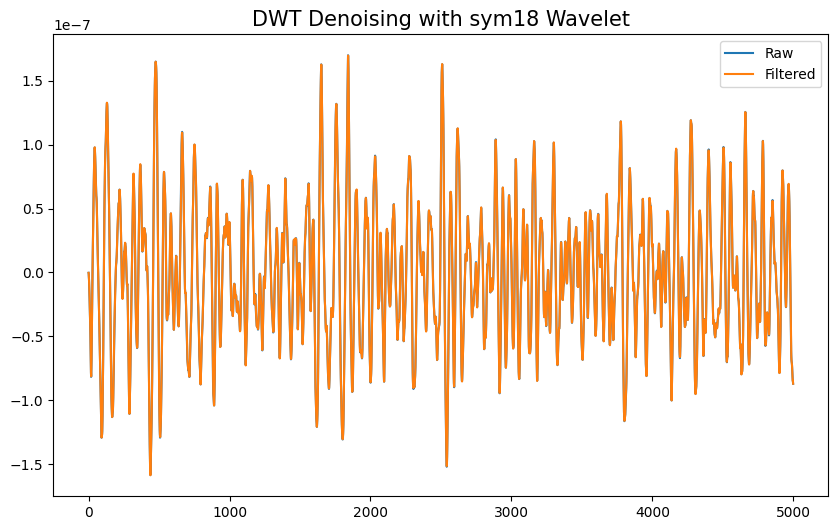

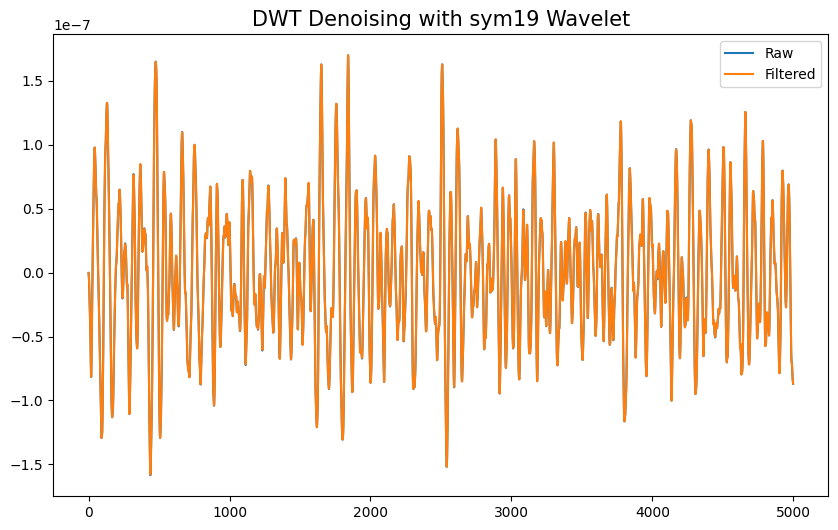

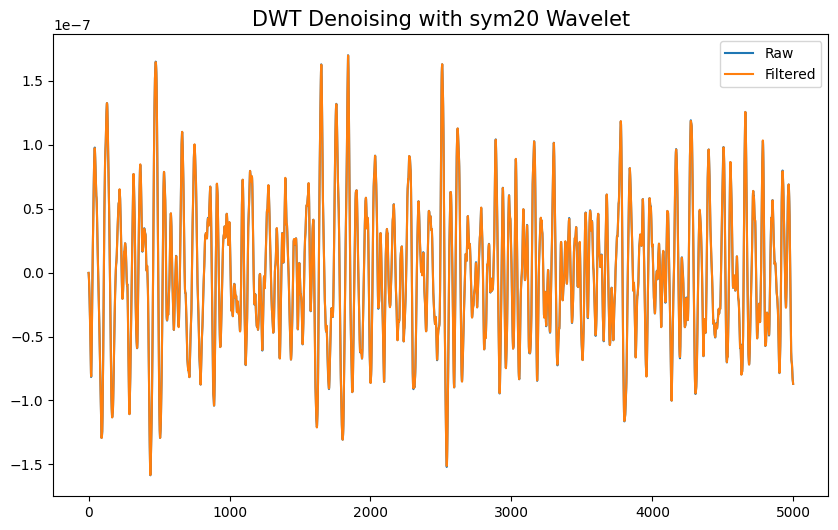

In [282]:
for wav in pywt.wavelist():
    try:
        filtered = wavelet_denoising(sample, wavelet=wav, level=1)
    except:
        pass
    
    plt.figure(figsize=(10, 6))
    plt.plot(sample, label='Raw')
    plt.plot(filtered, label='Filtered')
    plt.legend()
    plt.title(f"DWT Denoising with {wav} Wavelet", size=15)
    plt.show()